<center>
    <img width="100%" src="https://raw.githubusercontent.com/astroDimitrios/AstronomyClass/master/DesignAssets/Ai/Banner3plainCut.png" alt='AP Logo'>
</center>

# Closest Approach

Planets orbits are elliptical. We can model this ellipse using simple trig functions:

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
%matplotlib inline

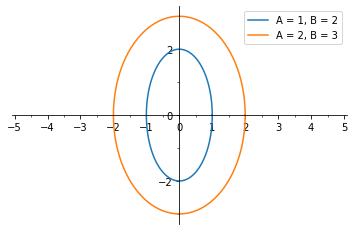

In [2]:
def ellipse(A, B):
    '''
    Makes an X and Y array of values to plot to get your ellipse
    '''
    start = 0
    step = 2*np.pi/100
    end = 2*np.pi + step
    phi = np.arange(start, end, step)
    X = A*np.cos(phi)
    Y = B*np.sin(phi)
    return (X, Y, A, B)

def plot_ellipse(E, newplot):
    '''
    Plots the ellipse created by ellipse()
    It does this on a new Figure if newplot == True
    Must be called differently depedning on the value of newplot:

    fig, ax = make_plot_ellipse(A,B,True)
    make_plot_ellipse(A,B,False)
    '''
    X = E[0]
    Y = E[1]
    A = E[2]
    B = E[3]
    if newplot == True:
        fig = plt.figure()
        ax = plt.subplot()
        ax.plot(X, Y, label='A = {}, B = {}'.format(A,B))
        ax.spines['bottom'].set_position('zero')
        ax.spines['left'].set_position('zero')
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.axis('equal')
        ax.xaxis.set_major_locator(plt.MultipleLocator(A))
        ax.xaxis.set_minor_locator(plt.MultipleLocator(A/2))
        ax.yaxis.set_major_locator(plt.MultipleLocator(B))
        ax.yaxis.set_minor_locator(plt.MultipleLocator(B/2))
        ax.legend(loc="upper right")
        return fig, ax
    else:
        ax = plt.gca()
        ax.plot(X, Y, label='A = {}, B = {}'.format(A,B))
        ax.legend(loc="upper right")
        return

def make_plot_ellipse(A, B, newplot):
    '''
    Creates the ellipse and plots it in one step
    '''
    thisEllipse = ellipse(A, B)
    thisPlot = plot_ellipse(thisEllipse, newplot)
    return thisPlot

# Create the first ellipse then add another on the same axis
fig1, ax1 = make_plot_ellipse(1,2,True)
make_plot_ellipse(2,3,False)

Here B is the semi-major axis, from 0 to the top or bottom edge of the ellipse.  
A is the semi-minor axis, from 0 to the left or right of the ellipse.

Let's plot the orbits of Earth and Mars. Then we can work out the distance between the planets at any time.

We first input our data and constants:

In [3]:
# Constants
AU = 1.495978707*10**11 # m

# Data for planets
planets = np.array(['Earth', 'Mars'])
perihelion = np.array([147.1, 206.6])*10**9 # m
aphelion = np.array([152.1, 249.2])*10**9 # m
period = np.array([365.2, 687.0]) # days

# Convert to AU
perihelion /= AU
aphelion /= AU

This function will create an array with the x and y positions of the planet at any time:

In [4]:
def orbitPeri(perihelion, aphelion, period, extend):
    '''
    Calculate orbit assuming planet starts at Perihelion
    '''
    step = 0.1
    stoptime = period*extend
    t = np.arange(0, stoptime+step, step)
    X = aphelion*np.sin(2*np.pi*t/period)
    Y = perihelion*np.cos(2*np.pi*t/period)
    return np.array([t, X, Y])

Let's use this fucntion to calcualte the orbits of Earth and Mars:

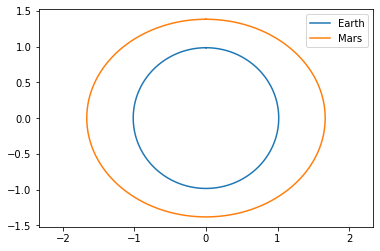

In [5]:
Earth = orbitPeri(perihelion[0], aphelion[0], period[0], 1)
Mars = orbitPeri(perihelion[1], aphelion[1], period[1], 1)

fig = plt.figure()
ax = plt.subplot()
ax.plot(Earth[1],Earth[2],label='Earth')
ax.plot(Mars[1],Mars[2],label='Mars')
ax.axis('equal')
ax.legend()

Notice that Mars' orbit is much more elliptical than the Earth's which is almost a perfect circle.

Let's calculate the distance between the two planets at any time using a new function:

In [6]:
def deltaR(planet1, planet2, t=None):
    '''
    Calculate distance between planets
    Optional time arg which is the end time to calculate orbital positions
    If not specified it will use the longest period of the two planets
    '''
    p1ind = np.where(planets==planet1)
    p2ind = np.where(planets==planet2)
    if t==None: t = max(period[p1ind],period[p2ind])
    else: t=t
    p1orbit = orbitPeri(perihelion[p1ind],aphelion[p1ind],period[p1ind],t/period[p1ind])
    p2orbit = orbitPeri(perihelion[p2ind],aphelion[p2ind],period[p2ind],t/period[p2ind])
    delX = p2orbit[1]-p1orbit[1]
    delY = p2orbit[2]-p1orbit[2]
    deltaR = np.sqrt(delX**2 + delY**2)
    return np.array([t, deltaR, min(deltaR), p1orbit, p2orbit, planet1, planet2])

# Specify planets to look at
p1 = 'Earth'
p2 = 'Mars'

# Calculate the distance between the two planets
dR = deltaR(p1,p2)
print(dR[2]) # Actual value ~0.36497845688 AU very close!

0.39773293377497243


C:\Users\polyq\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  app.launch_new_instance()


Notice we assumed both planets started at perihelion. The theoretical closest approach would be when Mars is at perihelion but the Earth is at aphelion. We can define a new orbit function to start the Earth's orbit at aphelion and then modify our deltaR function:

In [7]:
def orbitAph(perihelion, aphelion, period, extend):
    '''
    Calculate orbit assuming planet starts at Aphelion
    '''
    step = 0.1
    stoptime = period*extend
    t = np.arange(0, stoptime+step, step)
    X = perihelion*np.sin(2*np.pi*t/period)
    Y = aphelion*np.cos(2*np.pi*t/period)
    return np.array([t, X, Y])

def deltaR(planet1, planet2, t=None):
    '''
    Calculate distance between planets
    Optional time arg which is the end time to calculate orbital positions
    If not specified it will use the longest period of the two planets
    '''
    p1ind = np.where(planets==planet1)
    p2ind = np.where(planets==planet2)
    if t==None: t = max(period[p1ind],period[p2ind])
    else: t=t
    p1orbit = orbitAph(perihelion[p1ind],aphelion[p1ind],period[p1ind],t/period[p1ind])
    p2orbit = orbitPeri(perihelion[p2ind],aphelion[p2ind],period[p2ind],t/period[p2ind])
    delX = p2orbit[1]-p1orbit[1]
    delY = p2orbit[2]-p1orbit[2]
    deltaR = np.sqrt(delX**2 + delY**2)
    return np.array([t, deltaR, min(deltaR), p1orbit, p2orbit, planet1, planet2])

# Specify planets to look at
p1 = 'Earth'
p2 = 'Mars'

# Calculate the distance between the two planets
dR = deltaR(p1,p2)
print(dR[2]) # Actual value ~0.36497845688 AU very close!


0.3643099981636302


C:\Users\polyq\Anaconda3\lib\site-packages\ipykernel_launcher.py:27: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


deltaR takes an optional time argument to extend the time period to calculate orbits over (the default is the longest time period of the two planets). If we use this to extend our calculations over a much longer period of time we can calculate when the planets will be farthest from each other assuming they started at closest approach:

In [8]:
dRLONG = deltaR(p1,p2,1000000)
buffer = 0.00001
theoryMax = aphelion[1] + perihelion[0]
timeToMax = dRLONG[3][0][np.argmax(dRLONG[1]>(theoryMax-buffer))]/365.25
print(timeToMax)

257.21451060917184


C:\Users\polyq\Anaconda3\lib\site-packages\ipykernel_launcher.py:27: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


Over 257 years between the minimum and maximum separation of Earth and Mars!

We can see how this separation changes overtime in this animation:

In [9]:
Image('EarthMarsDistance.gif')

The code to replicate this animation is in **closestApproach.py**

# Challenge

1) Make an animation for a different pair of planets  
2) Calculate the time to closest approach assuming you start at the farthest approach  
3) Introduce a third body

## Sharing

If you share, use or modify this activity in any way use the citation in this [txt file](https://github.com/astroDimitrios/Astronomy/blob/master/CITATION.txt).    
Please contact me at astrodimitrios@gmail.com with any suggestions, mistakes found, or general questions about teaching astronomy with Python.

© Dimitrios Theodorakis GNU General Public License v3.0 https://github.com/astroDimitrios/Astronomy 